## We can pull data into our jupyter notebook

In [1]:
import pandas as pd
import boto3

s3 = boto3.client('s3')
obj = s3.get_object(Bucket='awsawsaws', Key='iris.csv')
df = pd.read_csv(obj['Body'])

print(df.head())

   Unnamed: 0  Petal length  Petal Width  Sepal Length  Sepal Width Species
0           0           5.1          3.5           1.4          0.2  setosa
1           1           4.9          3.0           1.4          0.2  setosa
2           2           4.7          3.2           1.3          0.2  setosa
3           3           4.6          3.1           1.5          0.2  setosa
4           4           5.0          3.6           1.4          0.2  setosa


## We can also call AWS Rekognition as a way to get information about an image

In [2]:
import pprint
import boto3

from PIL import Image, ImageDraw
from IPython.display import display

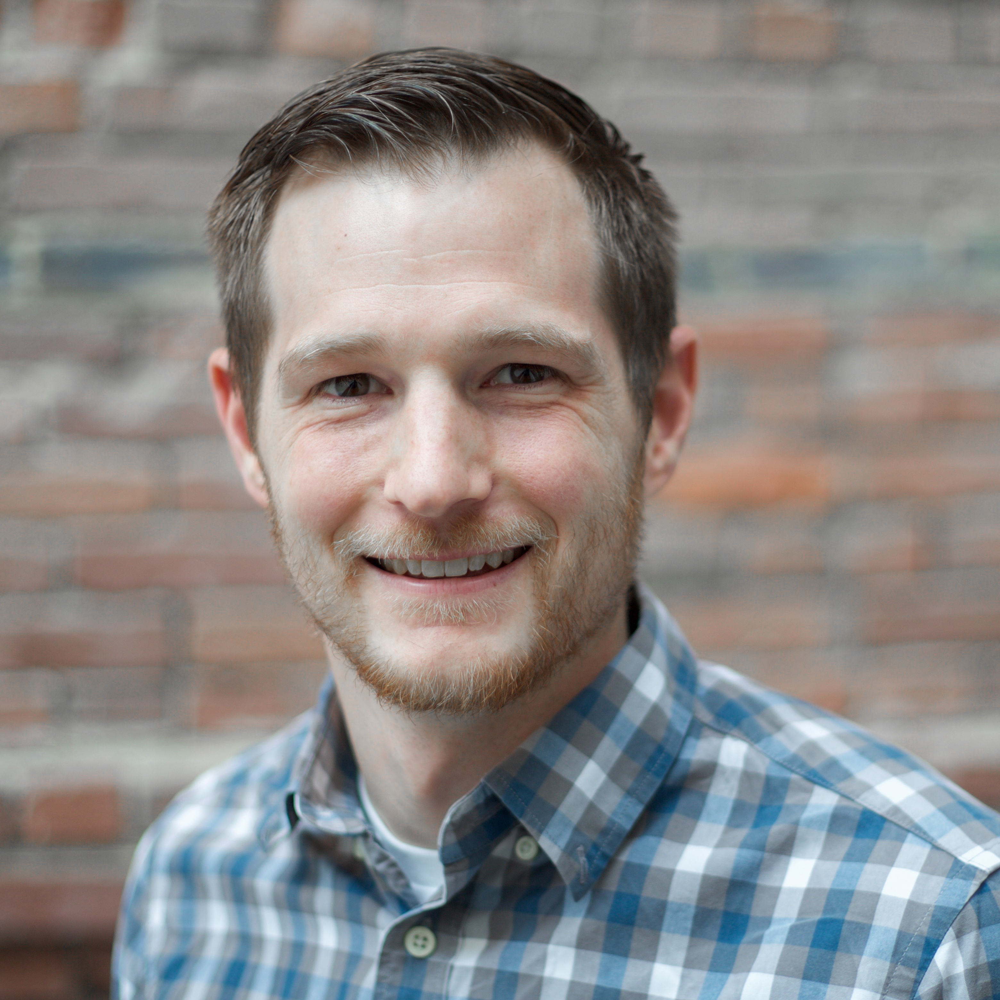

In [3]:
s3 = boto3.client('s3')

s3.download_file('awsawsaws', 'E98A3571.jpg', 'E98A3571.jpg')

display(Image.open('E98A3571.jpg'))

In [4]:
rek = boto3.client('rekognition', region_name='us-west-2')
with open('E98A3571.jpg', 'rb') as f:
    image_bytes = f.read()


In [5]:
response = rek.detect_labels(
    Image={ 'Bytes': image_bytes})
pprint.pprint(response)


{'LabelModelVersion': '2.0',
 'Labels': [{'Confidence': 99.84737396240234,
             'Instances': [],
             'Name': 'Apparel',
             'Parents': []},
            {'Confidence': 99.84737396240234,
             'Instances': [],
             'Name': 'Clothing',
             'Parents': []},
            {'Confidence': 99.84737396240234,
             'Instances': [{'BoundingBox': {'Height': 0.4306798577308655,
                                            'Left': 0.07793807983398438,
                                            'Top': 0.568999707698822,
                                            'Width': 0.9217415452003479},
                            'Confidence': 99.84737396240234}],
             'Name': 'Shirt',
             'Parents': [{'Name': 'Clothing'}]},
            {'Confidence': 98.90607452392578,
             'Instances': [{'BoundingBox': {'Height': 0.9201708436012268,
                                            'Left': 0.06525098532438278,
                        

In [6]:
response = rek.detect_faces(
Image={'Bytes':image_bytes}, Attributes=['ALL'])
pprint.pprint(response) 


{'FaceDetails': [{'AgeRange': {'High': 48, 'Low': 32},
                  'Beard': {'Confidence': 75.92469787597656, 'Value': True},
                  'BoundingBox': {'Height': 0.5493175387382507,
                                  'Left': 0.25876712799072266,
                                  'Top': 0.15685699880123138,
                                  'Width': 0.381733238697052},
                  'Confidence': 99.99995422363281,
                  'Emotions': [{'Confidence': 0.030892755836248398,
                                'Type': 'FEAR'},
                               {'Confidence': 0.017007041722536087,
                                'Type': 'SAD'},
                               {'Confidence': 0.061848148703575134,
                                'Type': 'CALM'},
                               {'Confidence': 99.35420989990234,
                                'Type': 'HAPPY'},
                               {'Confidence': 0.19170410931110382,
                                '

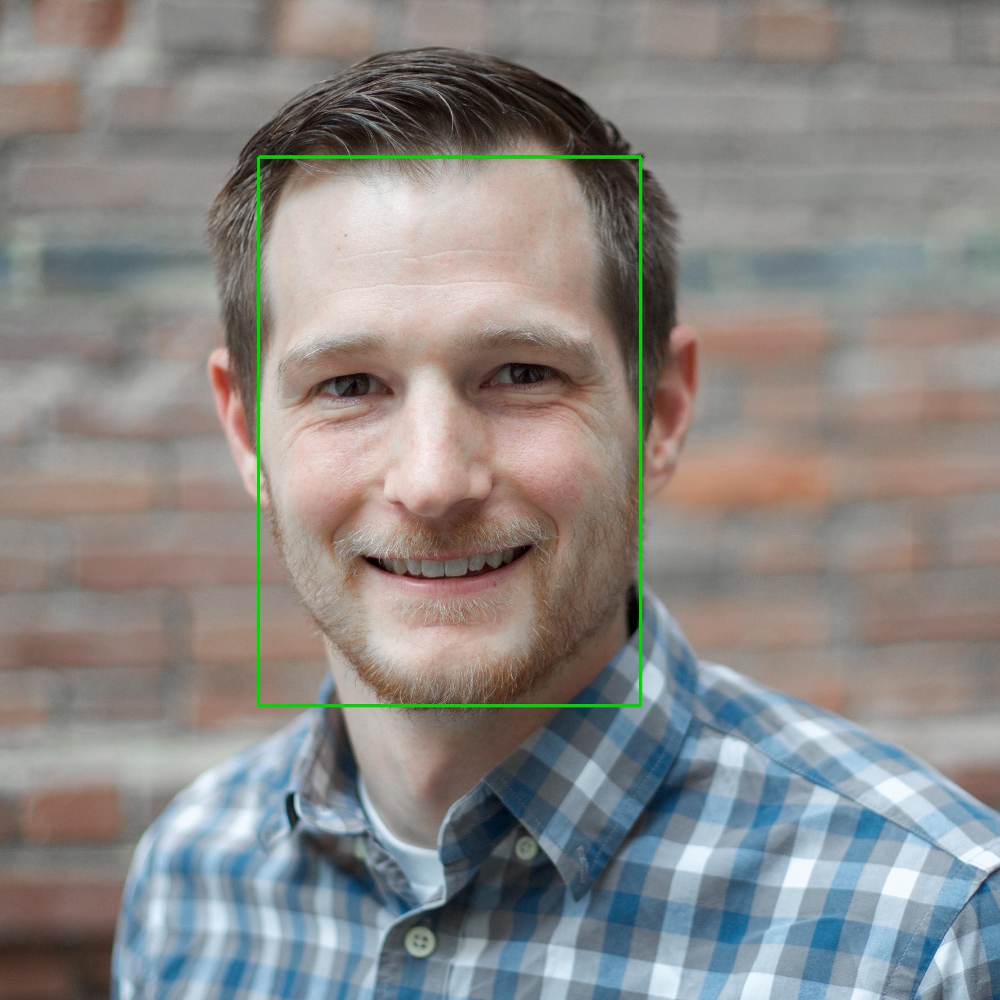

In [7]:
src = Image.open('E98A3571.jpg')
draw1 = ImageDraw.Draw(src)
width, height = src.size
img = Image.new('RGB', src.size)
draw = ImageDraw.Draw(img)
img.paste(src, (0,0))

imgWidth, imgHeight = img.size  

for faceDetail in response['FaceDetails']:
    box = faceDetail['BoundingBox']
    left = imgWidth * box['Left']
    top = imgHeight * box['Top']
    width = imgWidth * box['Width']
    height = imgHeight * box['Height']
    
    points = (
        (left,top),
        (left + width, top),
        (left + width, top + height),
        (left , top + height),
        (left, top)

    )
    draw.line(points, fill='#00d400', width=10)
    
img.save('E98A3571_bounding.jpg')
display(Image.open('E98A3571_bounding.jpg'))

## We can also use SageMaker to make predicitons on the text we obtained